In [1]:
import cv2 
import pandas as pd
from skimage.io import imread
import matplotlib.pyplot as plt
import os
from skimage.io import imread
import tensorflow as tf
import numpy as np
from sklearn.model_selection import train_test_split
from skimage.transform import resize
from tensorflow import keras
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from tensorflow.keras.models import load_model
import skimage

2024-07-23 13:09:47.321473: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-07-23 13:09:47.321579: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-07-23 13:09:47.469973: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [2]:
truth_csv = pd.read_csv('/kaggle/input/ham1000-segmentation-and-classification/GroundTruth.csv')
full_csv = truth_csv.map(lambda x: True if x == 1.0 else (False if x == 0.0 else x))

In [3]:
parent_path_ims = "/kaggle/input/ham1000-segmentation-and-classification/images"
img_file_names = os.listdir(parent_path_ims)
img_file_names.remove('ATTRIBUTION.txt')
img_file_names.remove('LICENSE.txt')
img_paths_list = [os.path.join(parent_path_ims, name) for name in img_file_names]


# Helping Functions

In [4]:
def ret_imgname(image_path):
    splits = image_path.split("/")
    last_parts = splits[-1].split(".")
    
    return last_parts[0]

def ret_maskpath(image_path):
    image_part_removed = image_path[:54]
    mask_path = image_part_removed + "masks/" + ret_imgname(image_path)+"_segmentation.png"
    
    return mask_path

def ret_imgpath(img_id):
    return f"/kaggle/input/ham1000-segmentation-and-classification/images/{img_id}.jpg"

In [5]:
import albumentations as A

def augment_data(image, mask):
    # Ensure mask is in the correct format
    image = image.astype(np.float32)
    mask = mask.astype(np.float32)
    
    # Define augmentation pipeline
    aug = A.Compose([
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.7),
        A.RandomRotate90(p=0.7),
        A.Transpose(p=0.5),
        A.Resize(192,256,p=1),
        
        
        # Blur and Sharpness
        A.OneOf([
            A.GaussianBlur(blur_limit=(3, 7), p=0.5),
            A.MotionBlur(blur_limit=7, p=0.5),
            A.MedianBlur(blur_limit=7, p=0.5),
            A.Sharpen(alpha=(0.2, 0.5), lightness=(0.5, 1.0), p=0.5),
        ], p=0.5),
        
    ])
    
    # Apply augmentation
    augmented = aug(image=image, mask=mask)
    return augmented['image'], augmented['mask']

In [6]:
def balance_dataset(full_csv, cutoff=1000,target_samples = 1100,nv_samples=1100):
    balanced_df = pd.DataFrame()
    
    for column in ['MEL', 'NV', 'BCC', 'AKIEC', 'BKL', 'DF', 'VASC']:
        class_df = full_csv[full_csv[column] == 1.0]
        
        if column == 'NV':
            class_df = class_df.sample(n=nv_samples, random_state=42)
        
        elif len(class_df) > cutoff:
            print(f"Did nothing as there were enough samples of the class {column}; there were {len(class_df)} samples of {column}")
    
        elif len(class_df) < cutoff:
            multiplier = int(np.ceil(target_samples / len(class_df)))
            class_df = pd.concat([class_df] * multiplier).sample(n=target_samples, replace=False, random_state=42)
        else:
            class_df = class_df.sample(n=target_samples, random_state=42)
        
        balanced_df = pd.concat([balanced_df, class_df])
    
    return balanced_df.reset_index(drop=True)


In [7]:
def load_image_and_mask(image_path, height=192, width=256, is_training=True, apply_augmentation=True):
    image = imread(image_path)
    image = resize(image, (height, width))
    
    
    if is_training:
        image_name = ret_imgname(image_path)
        mask_path = ret_maskpath(image_path)
        
        mask = imread(mask_path, as_gray=True)
        mask = resize(mask, (height, width))
        
        row = full_csv[full_csv['image'] == image_name].index[0]
        true_column = full_csv.columns[full_csv.loc[row] == True][0]
        column_index = full_csv.columns.get_loc(true_column)
        channel_index = column_index - 1
        
        ret_mask = np.zeros((height, width, 7), dtype=np.float32)
        ret_mask[:,:,channel_index] = mask
        
        if apply_augmentation:
            image, ret_mask = augment_data(image, ret_mask)
            
         # Normalizing the image
        p2, p98 = np.percentile(image, (2, 98))
        image = skimage.exposure.rescale_intensity(image, in_range=(p2, p98), out_range=(0, 1))

        ret_mask = np.where(ret_mask >= 0.9, 1.0, 0.0).astype(np.float32)

        
        return image, ret_mask
    else:
        return image

# Checking out different image normalization methods


/opt/conda/lib/python3.10/site-packages/skimage/_shared/utils.py:316: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)


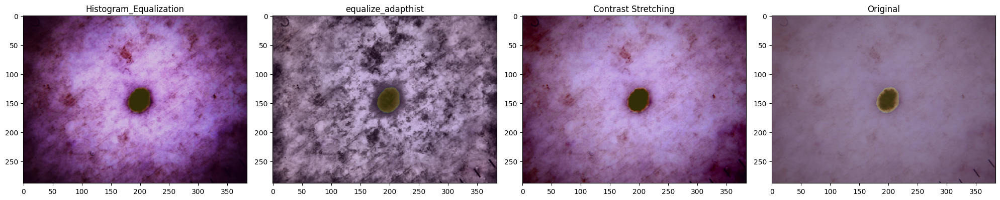

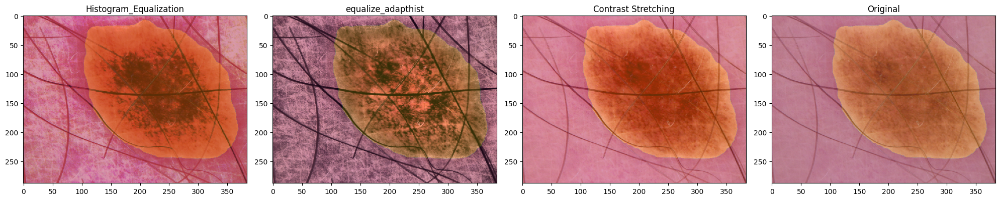

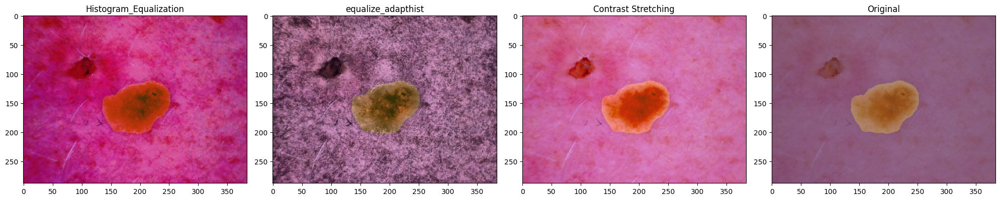

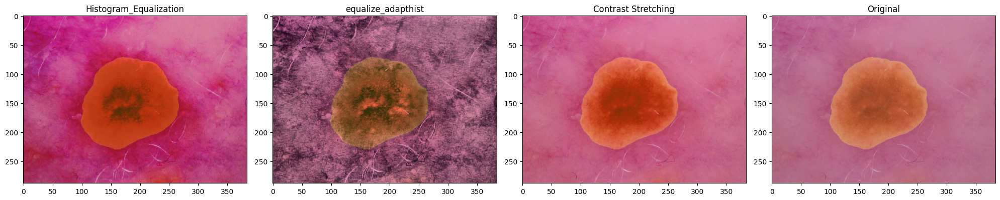

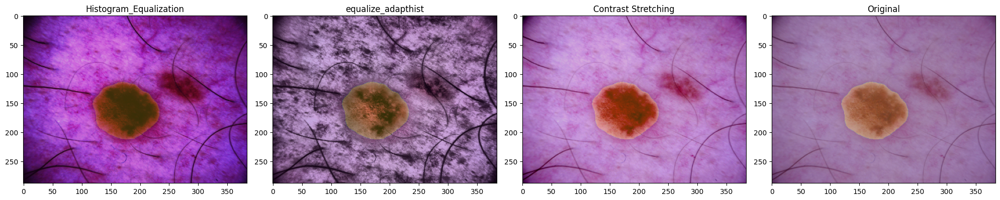

...

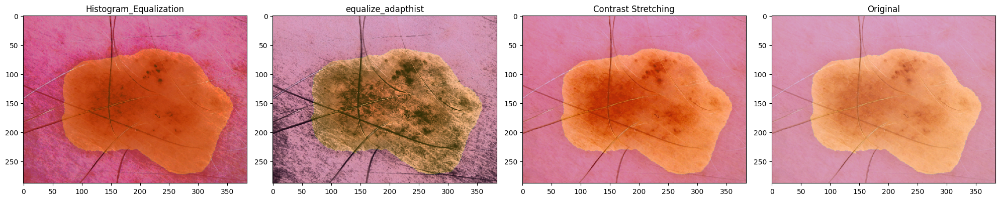

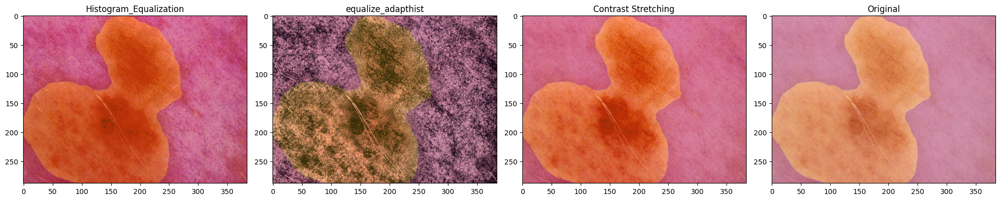

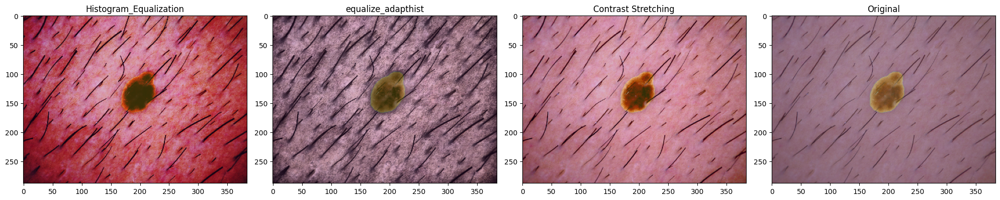

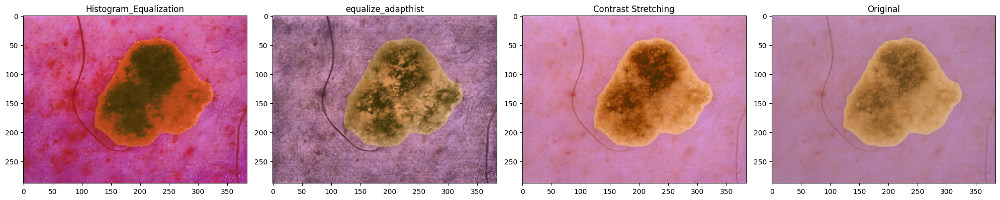

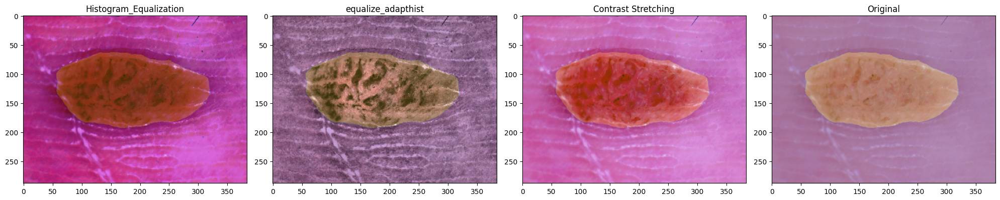

In [8]:
for i in range(20):
    img_path = img_paths_list[i]
    
    image=resize(imread(img_path),(9*32,12*32))
    
    hist_img =skimage.exposure.equalize_hist(image)
    im_norm = image/255.0
    img_adapteq = skimage.exposure.equalize_adapthist(image, clip_limit=0.03)
    
    p2, p98 = np.percentile(image, (2, 98))
    img_rescale = skimage.exposure.rescale_intensity(image, in_range=(p2, p98))

    
    mask = resize(imread(ret_maskpath(img_path)),(9*32,12*32))
    
    plt.figure(figsize=(20,20))
    
    plt.subplot(1,4,1)
    plt.title("Histogram_Equalization")
    plt.imshow(hist_img)
    plt.imshow(mask,alpha = 0.2)
    
    plt.subplot(1,4,2)
    plt.title("equalize_adapthist")
    plt.imshow(img_adapteq)
    plt.imshow(mask,alpha = 0.2)
    
    plt.subplot(1,4,3)
    plt.title("Contrast Stretching")
    plt.imshow(img_rescale)
    plt.imshow(mask,alpha = 0.2)
    
    plt.subplot(1,4,4)
    plt.title("Original")
    plt.imshow(image)
    plt.imshow(mask,alpha = 0.2)
    
    plt.tight_layout()
    plt.show()
    


**Contrast Stretching seems to give the best performance as it is highlighting the target area pretty well.**

# Data Loading Pipeline

In [9]:
class Dataloader(tf.keras.utils.Sequence):
    def __init__(self, image_paths, is_training=True, batch_size=16, height=192, width=256, apply_augmentation=True):
        self.image_paths = image_paths
        self.is_training = is_training
        self.batch_size = batch_size
        self.height = height
        self.width = width
        self.apply_augmentation = apply_augmentation
        
        super().__init__(workers=8)
        
    def __len__(self):
        return int(np.ceil(len(self.image_paths) / self.batch_size))
        
    def __getitem__(self, index):
        start = index * self.batch_size
        end = min((index + 1) * self.batch_size, len(self.image_paths))
        
        batch_paths = self.image_paths[start:end]
        X = np.empty((end - start, self.height, self.width, 3), dtype=np.float32)
        
        if self.is_training:
            Y = np.empty((end - start, self.height, self.width, 7), dtype=np.float32)
        
        for i, path in enumerate(batch_paths):
            if self.is_training:
                image, mask = load_image_and_mask(path, height=self.height, width=self.width, 
                                                  is_training=self.is_training, apply_augmentation=self.apply_augmentation)
                X[i] = image
                Y[i] = mask
            else: 
                image = load_image_and_mask(path, height=self.height, width=self.width, 
                                            is_training=self.is_training)
                X[i] = image
                
        if self.is_training:
            return X, Y
        return X


In [10]:
balanced_df = balance_dataset(truth_csv)
balanced_df=balanced_df.sample(n=len(balanced_df))
image_paths = balanced_df['image'].apply(ret_imgpath).tolist()

Did nothing as there were enough samples of the class MEL; there were 1113 samples of MEL
Did nothing as there were enough samples of the class BKL; there were 1099 samples of BKL


In [11]:
train_list,validation_list = train_test_split(image_paths,test_size = 0.75,random_state=42)

In [12]:
train_dataloader= Dataloader(train_list,True)
validation_dataloader= Dataloader(validation_list,True,apply_augmentation=False)

**Batch Visualization**

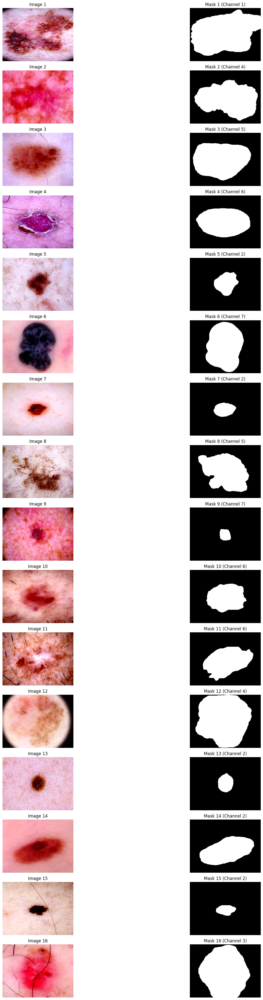

In [13]:
im,ma = train_dataloader.__getitem__(15)

def plot_batch(images, masks, num_images=16, figsize=(20, 40)):
    """
    Plot a batch of images and their corresponding masks side by side with larger size.
    
    :param images: Batch of images (shape: [batch_size, height, width, channels])
    :param masks: Batch of masks (shape: [batch_size, height, width, 7])
    :param num_images: Number of images to plot (default: 16)
    :param figsize: Figure size (default: (20, 40))
    """
    num_images = min(num_images, images.shape[0])
    fig, axes = plt.subplots(num_images, 2, figsize=figsize)
    
    for i in range(num_images):
        # Plot image
        axes[i, 0].imshow(images[i])
        axes[i, 0].axis('off')
        axes[i, 0].set_title(f'Image {i+1}', fontsize=12)
        
        # Find the channel with 1.0 and plot the corresponding mask
        mask = masks[i]
        channel_index = np.where(mask.max(axis=(0, 1)) == 1.0)[0]
        if len(channel_index) > 0:
            channel_index = channel_index[0]
            axes[i, 1].imshow(mask[:, :, channel_index], cmap='gray')
            axes[i, 1].set_title(f'Mask {i+1} (Channel {channel_index+1})', fontsize=12)
        else:
            axes[i, 1].imshow(np.zeros_like(mask[:, :, 0]), cmap='gray')
            axes[i, 1].set_title(f'Mask {i+1} (No 1.0 found)', fontsize=12)
        axes[i, 1].axis('off')
    
    plt.tight_layout()
    plt.show()
    
plot_batch(im,ma)

In [14]:
os.environ["SM_FRAMEWORK"] = "tf.keras"
!pip install segmentation_models --quiet
import segmentation_models as sm

sm.set_framework('tf.keras')
keras.backend.set_image_data_format('channels_last')


/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


Segmentation Models: using `tf.keras` framework.


# **Model Training**

In [15]:
from segmentation_models.metrics import FScore 
from segmentation_models.metrics import IOUScore
from segmentation_models.losses import DiceLoss

In [16]:
backbone = 'seresnext50'

model = sm.FPN(backbone,encoder_weights='imagenet',input_shape=(192,256,3),classes=7,encoder_freeze=True,activation = 'sigmoid')

104679448/104679448 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


In [17]:
model.compile(
    optimizer = tf.keras.optimizers.Adam(0.0009),
    loss= DiceLoss(),
    metrics=[FScore(),IOUScore()],
)

early_stopping = EarlyStopping(
    patience=4,
    min_delta=0.0001,
    restore_best_weights=True,
)


# Reduce learning rate on plateau
lr_plateau = keras.callbacks.ReduceLROnPlateau(
    monitor="val_loss",
    factor=0.75,
    patience=3,
    verbose=1,
    min_delta=0.0001,
)

In [18]:
history = model.fit(
    train_dataloader,
    epochs=40,
    validation_data = validation_dataloader,
    callbacks = [early_stopping,lr_plateau],
    verbose = 1
)

Epoch 1/40


I0000 00:00:1721740427.194491      74 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


121/121 ━━━━━━━━━━━━━━━━━━━━ 447s 2s/step - f1-score: 0.2456 - iou_score: 0.1559 - loss: 0.7542 - val_f1-score: 0.2602 - val_iou_score: 0.1688 - val_loss: 0.7399 - learning_rate: 9.0000e-04
Epoch 2/40
121/121 ━━━━━━━━━━━━━━━━━━━━ 192s 2s/step - f1-score: 0.4199 - iou_score: 0.2976 - loss: 0.5801 - val_f1-score: 0.3434 - val_iou_score: 0.2349 - val_loss: 0.6565 - learning_rate: 9.0000e-04
Epoch 3/40
121/121 ━━━━━━━━━━━━━━━━━━━━ 192s 2s/step - f1-score: 0.4723 - iou_score: 0.3504 - loss: 0.5277 - val_f1-score: 0.4121 - val_iou_score: 0.2993 - val_loss: 0.5878 - learning_rate: 9.0000e-04
Epoch 4/40
121/121 ━━━━━━━━━━━━━━━━━━━━ 192s 2s/step - f1-score: 0.4976 - iou_score: 0.3725 - loss: 0.5023 - val_f1-score: 0.4795 - val_iou_score: 0.3597 - val_loss: 0.5206 - learning_rate: 9.0000e-04
Epoch 5/40
121/121 ━━━━━━━━━━━━━━━━━━━━ 192s 2s/step - f1-score: 0.5464 - iou_score: 0.4192 - loss: 0.4535 - val_f1-score: 0.5013 - val_iou_score: 0.3832 - val_loss: 0.4988 - learning_rate: 9.0000e-04
Epoch 

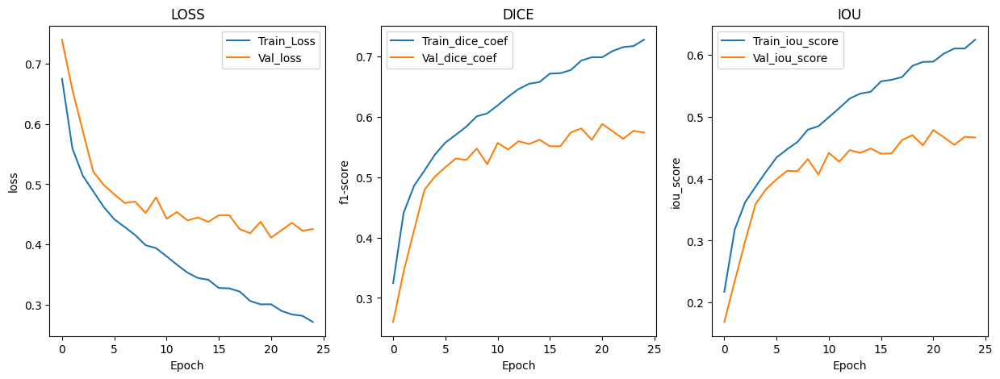

In [19]:
hist_df = pd.DataFrame(history.history)
hist_df.to_csv('history_FPN_seresnext50_skin_cancer_augmentation.csv')

# PLOT TRAINING
plt.figure(figsize=(15,5))
plt.subplot(1,3,1)
plt.plot(range(history.epoch[-1]+1),history.history['loss'],label='Train_Loss')
plt.plot(range(history.epoch[-1]+1),history.history['val_loss'],label='Val_loss')
plt.title('LOSS'); plt.xlabel('Epoch'); plt.ylabel('loss');plt.legend();

plt.subplot(1,3,2)
plt.plot(range(history.epoch[-1]+1),history.history['f1-score'],label='Train_dice_coef')
plt.plot(range(history.epoch[-1]+1),history.history['val_f1-score'],label='Val_dice_coef')
plt.title('DICE'); plt.xlabel('Epoch'); plt.ylabel('f1-score');plt.legend(); 

plt.subplot(1,3,3)
plt.plot(range(history.epoch[-1]+1),history.history['iou_score'],label='Train_iou_score')
plt.plot(range(history.epoch[-1]+1),history.history['val_iou_score'],label='Val_iou_score')
plt.title('IOU'); plt.xlabel('Epoch'); plt.ylabel('iou_score');plt.legend(); 

plt.show()


In [20]:
model.save('FPN_seresnext50_skin_cancer_augmentation.h5')